In [1]:
print("ashish")
!pwd

ashish
/home/ashishr/my_project_github_check/Experiments_FPGM


In [34]:
import os
%cd ../Data
# Install required packages and download data if not already present
if not os.path.exists('open-images-bus-trucks'):
    !wget --quiet https://www.dropbox.com/s/agmzwk95v96ihic/open-images-bus-trucks.tar.xz
    !tar -xf open-images-bus-trucks.tar.xz
    !rm open-images-bus-trucks.tar.xz
%cd ../Experiments_FPGM

/home/ashishr/my_project_github_check/Data
/home/ashishr/my_project_github_check/Experiments_FPGM


In [35]:
# Move to the 'annotations' directory and copy annotation files
%cd ../Data/open-images-bus-trucks/annotations
!cp mini_open_images_train_coco_format.json instances_train2017.json
!cp mini_open_images_val_coco_format.json instances_val2017.json
%cd ../../../Experiments_FPGM

/home/ashishr/my_project_github_check/Data/open-images-bus-trucks/annotations
/home/ashishr/my_project_github_check/Experiments_FPGM


In [36]:
# Move back to the main directory
%cd ../Data/open-images-bus-trucks
# Create symbolic links for image directories
!ln -s images/ train2017
!ln -s images/ val2017
# Change to the 'detr' directory
%cd ../../Experiments_FPGM

/home/ashishr/my_project_github_check/Data/open-images-bus-trucks
/home/ashishr/my_project_github_check/Experiments_FPGM


In [37]:
# Define the classes for detection
CLASSES = ['', 'BUS','TRUCK']

In [38]:
# Import required libraries
from torch_snippets import *
# Check if the pretrained model is available, and if not, download it
if not os.path.exists('detr-r50-e632da11.pth'):
    !wget https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth
    checkpoint = torch.load("detr-r50-e632da11.pth", map_location='cpu')
    del checkpoint["model"]["class_embed.weight"]
    del checkpoint["model"]["class_embed.bias"]
    torch.save(checkpoint,"detr-r50_no-class-head.pth")

In [213]:
# Run the main script to train the model
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/\
  --epochs 4 --lr=1e-4 --batch_size=2 --num_workers=4\
  --output_dir="output_detr_without_prune" --resume="../Data/detr-r50_no-class-head.pth"



*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 1): env://
| distributed init (rank 2): env://
| distributed init (rank 0): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.2.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer2.0.conv1.weight, Nonzero weights: 32768, Zero weights: 0
Module name: layer2.0.conv2.weight, Nonzero weights: 147456, Zero weights: 0
Module name: layer2.0.conv3.weight, Nonzero weights: 65536, Zero weights: 0
Module name: layer2.0.downsample.0.weight, Nonzero weights: 131072, Zero 

In [62]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 10 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm" --resume="detr-r50_no-class-head.pth" --rate_dist 0.3 --layer_begin 50 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 2): env://
| distributed init (rank 0): env://
| distributed init (rank 1): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer4.2.conv1.weight, Nonzero weights: 1048576, Zero weights: 0
Module name: layer4.2.conv2.weight, Nonzero weights: 2359296, Zero weights: 0
Module name: layer4.2.conv3.weight, Nonzero weights: 1048576, Zero weights: 0
mask Ready
mask Done
mask similar Done
Module name: layer4.2.conv1.weight, Nonzero weights: 735232, Zero weights: 313344
Module name: layer4.2.c

In [1]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 10 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0.3 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 1): env://
| distributed init (rank 0): env://
| distributed init (rank 2): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [ ]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 1 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm_plots" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0.3 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 0): env://
| distributed init (rank 1): env://
| distributed init (rank 2): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [2]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 50 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm_RD0.3" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0.3 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 0): env://
| distributed init (rank 1): env://
| distributed init (rank 2): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [3]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 50 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm_RD0.6" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0.6 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 2): env://
| distributed init (rank 1): env://
| distributed init (rank 0): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [4]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 50 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm_l2_RN0.7" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0 --rate_norm 0.7 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 1): env://
| distributed init (rank 0): env://
| distributed init (rank 2): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [5]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 50 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm_l2_RN0.4" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0 --rate_norm 0.4 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 2): env://
| distributed init (rank 1): env://
| distributed init (rank 0): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [6]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 50 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm_l1_RN0.7" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0 --rate_norm 0.7 --dist_type l1 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 2): env://
| distributed init (rank 1): env://
| distributed init (rank 0): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [ ]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 50 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm_l1_RN0.4" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0 --rate_norm 0.4 --dist_type l1 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 0): env://
| distributed init (rank 2): env://
| distributed init (rank 1): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [3]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/   --epochs 50 --lr=1e-4 --batch_size=2 --num_workers=4   --output_dir="DETR_output_fpgm_0C" --resume="../Data/detr-r50_no-class-head.pth" --rate_dist 0 --layer_begin 5 --layer_end 140 


*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 1): env://
| distributed init (rank 0): env://
| distributed init (rank 2): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.1.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.1.conv2.weight, Nonzero weights: 36864, Zero weights: 0
Module name: layer1.1.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv1.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer1.2.conv2.weight, Nonzero weights: 36864, Zero weights: 

In [71]:
# Load the trained model
import sys
sys.path.append('../DETR_pruning')

from prune_detr_FPGM_L1_L2 import get_args_parser, argparse, build_model
parser = argparse.ArgumentParser('DETR training and evaluation script', parents=[get_args_parser()])
args, _ = parser.parse_known_args()

model, _, _ = build_model(args)
model.load_state_dict(torch.load("DETR_output_fpgm/best_checkpoint.pth")['model']);

In [73]:
# Load the trained model
import sys
sys.path.append('../DETR_pruning')

from prune_detr_FPGM_L1_L2 import get_args_parser, argparse, build_model
parser = argparse.ArgumentParser('DETR training and evaluation script', parents=[get_args_parser()])
args, _ = parser.parse_known_args()

model_without_pruned, _, _ = build_model(args)
model_without_pruned.load_state_dict(torch.load("output_detr_without_prune/best_checkpoint.pth")['model']);

In [68]:
print(model)

DETR(
  (transformer): Transformer(
    (encoder): TransformerEncoder(
      (layers): ModuleList(
        (0): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (1): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (2): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (3): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (4): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (5): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
      )
    )
    (decoder): TransformerDecoder(
      (layer

In [69]:
# Import required libraries for visualization
from PIL import Image, ImageDraw, ImageFont

# standard PyTorch mean-std input image normalization
# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]
# Define the transformation for input images
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Define functions for bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b
    
def detect(im, model, transform):
    img = transform(im).unsqueeze(0)
    assert img.shape[-2] <= 1600 and img.shape[-1] <= 1600, 'demo model only supports images up to 1600 pixels on each side'
    outputs = model(img)
    # keep only predictions with 0.7+ confidence
    probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > 0.7
    # convert boxes from [0; 1] to image scales
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
    return probas[keep], bboxes_scaled

def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), COLORS * 100):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

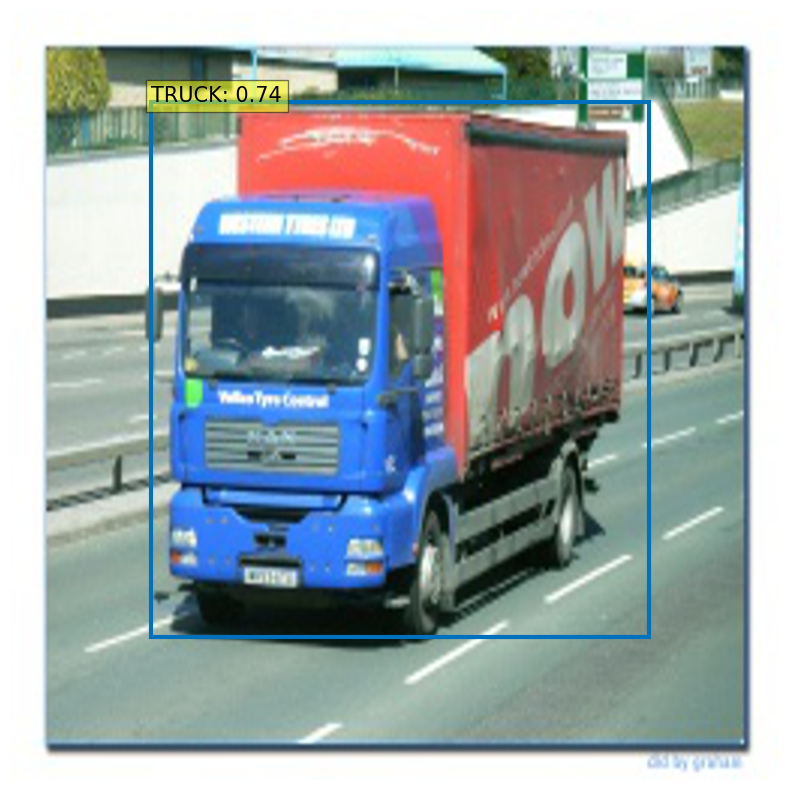

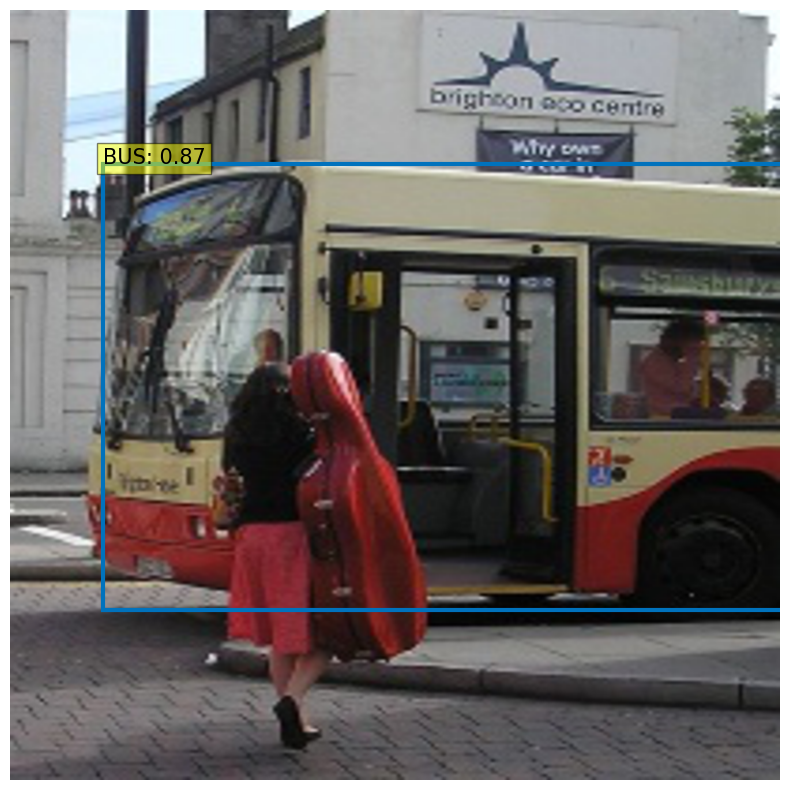

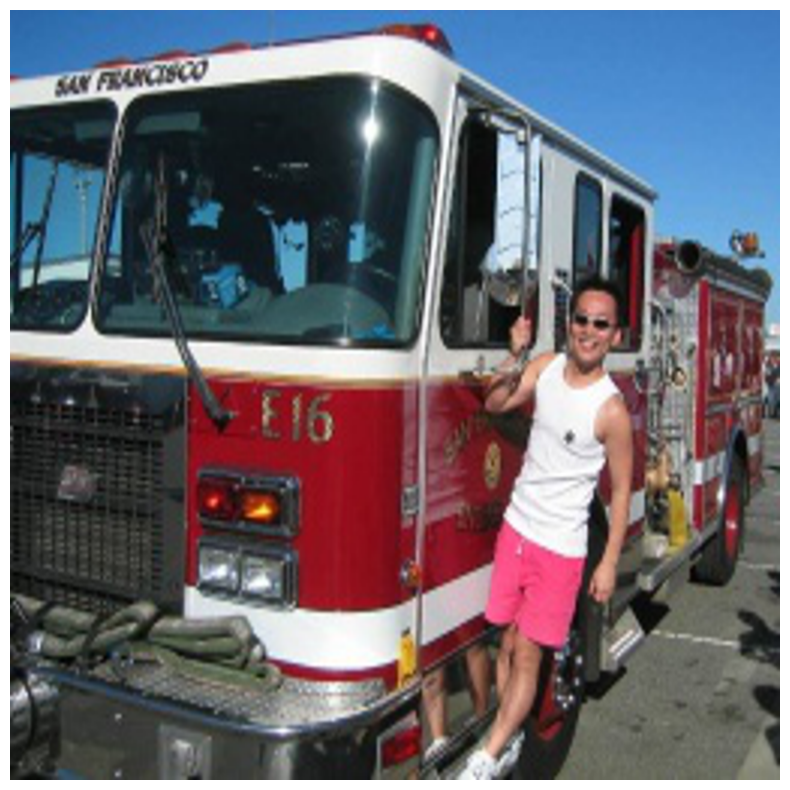

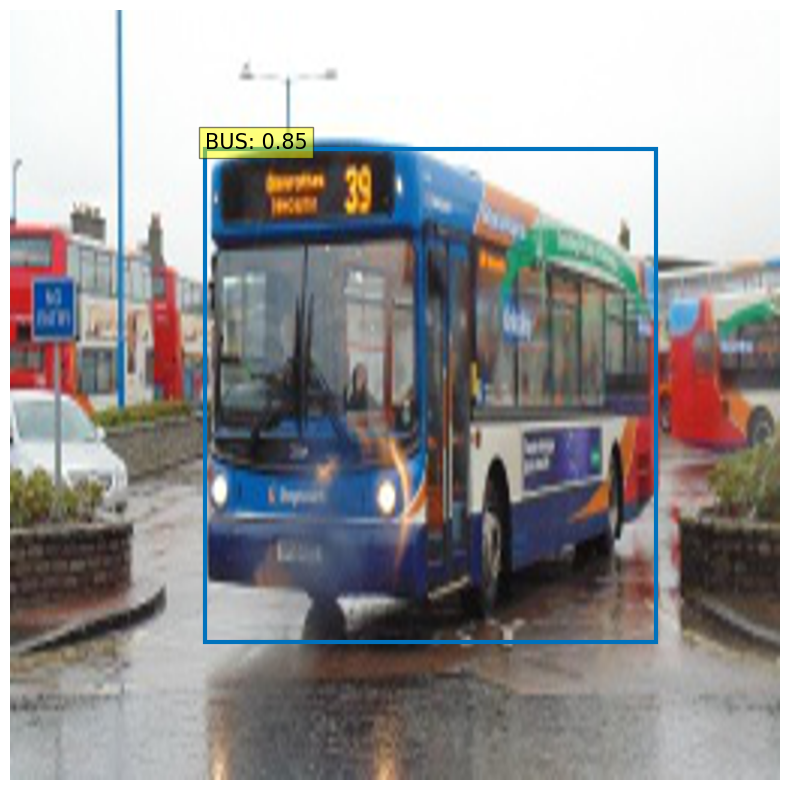

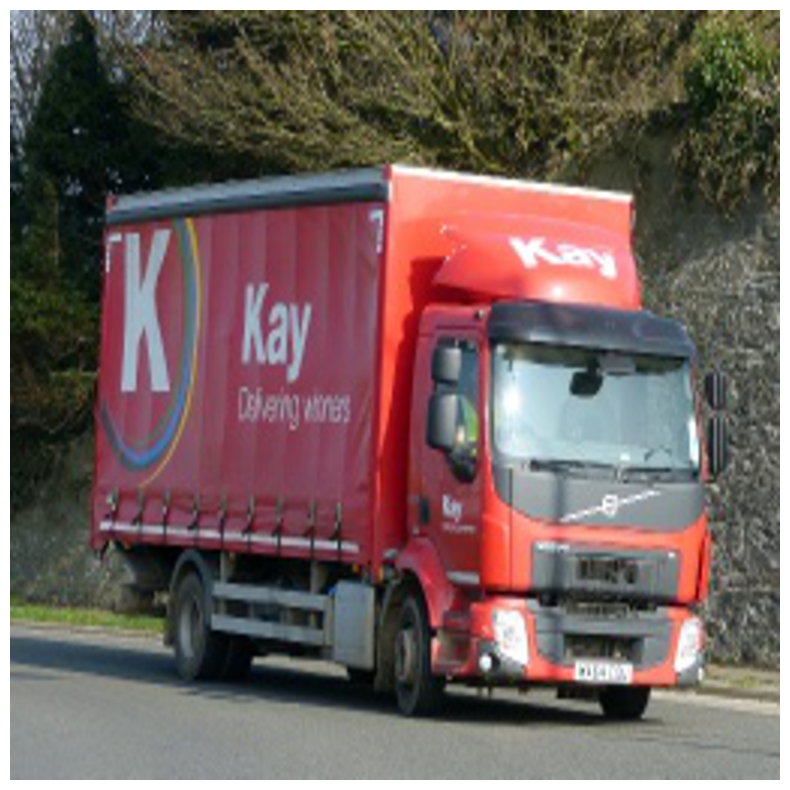

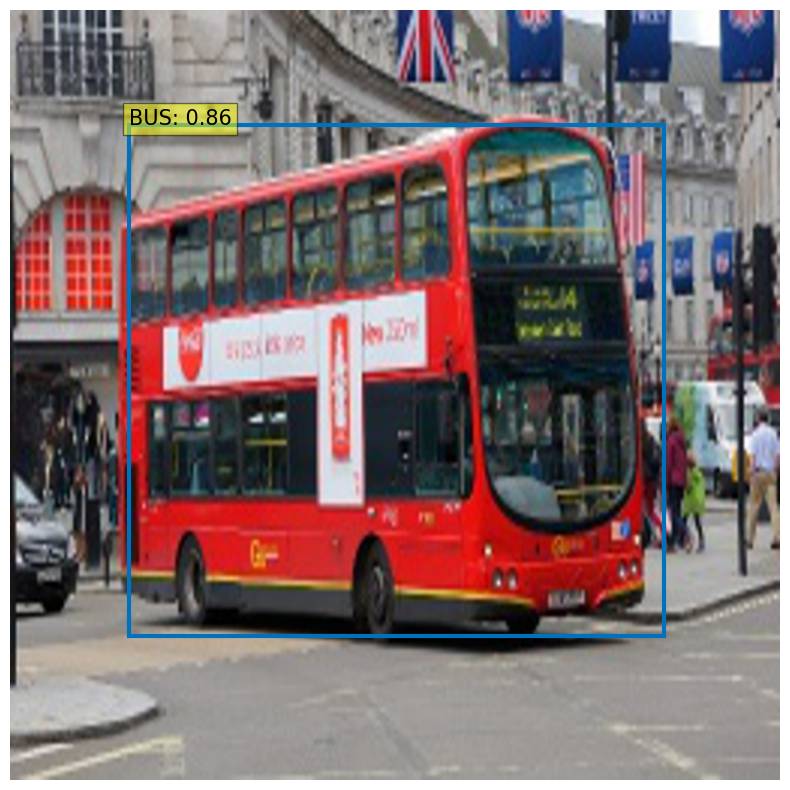

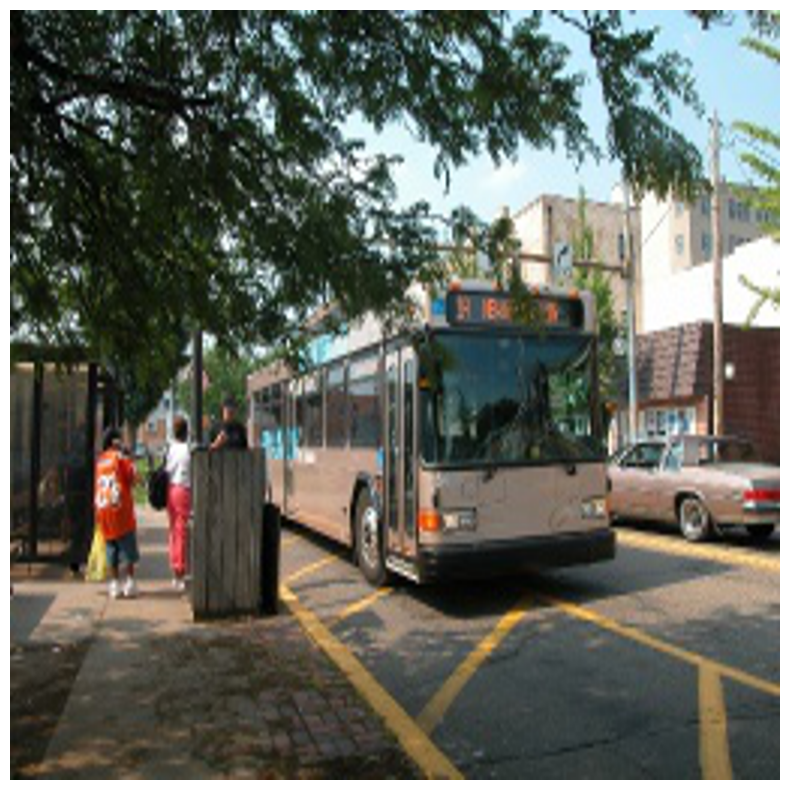

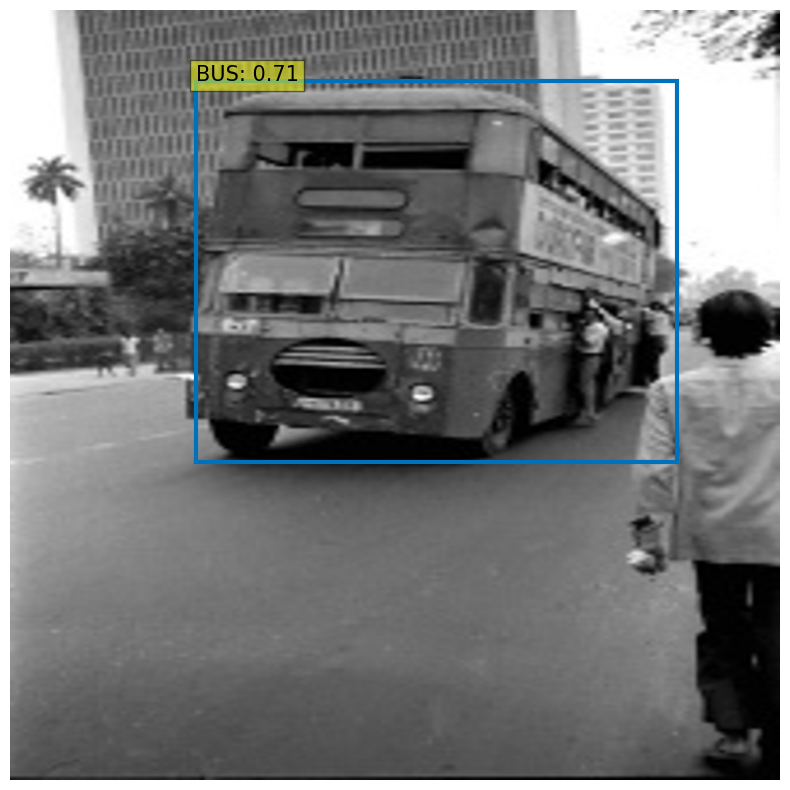

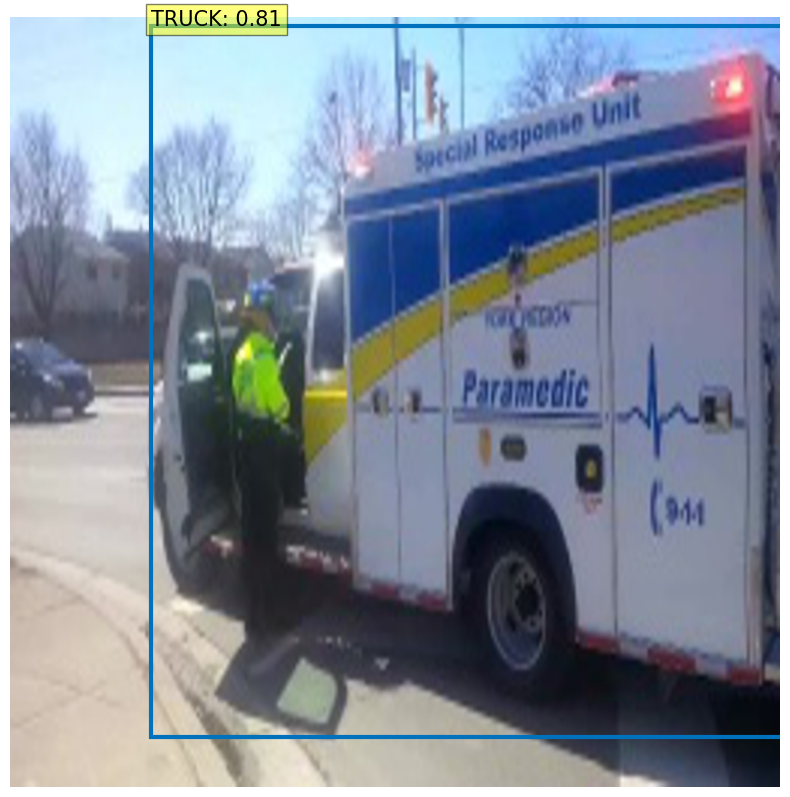

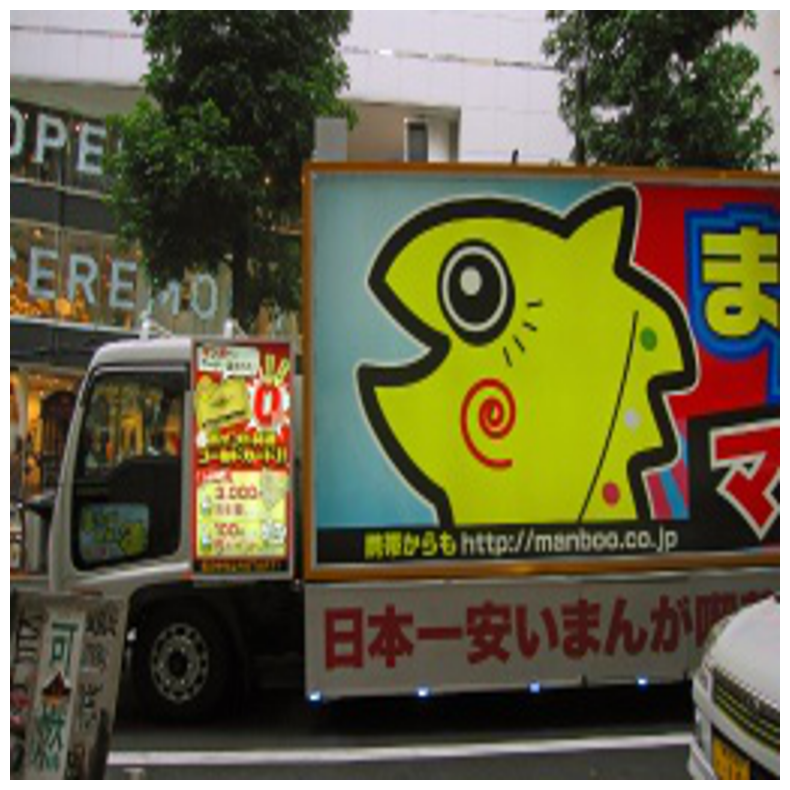

In [74]:
# Perform object detection on sample images
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for _ in range(10):
    # Choose a random image from the dataset
    image = Image.open(choose(Glob('../Data/open-images-bus-trucks/images/*'))).resize((800,800)).convert('RGB')
    # Detect objects in the image using the trained model
    scores, boxes = detect(image, model_without_pruned, transform)
     # Visualize the results
    plot_results(image, scores, boxes)

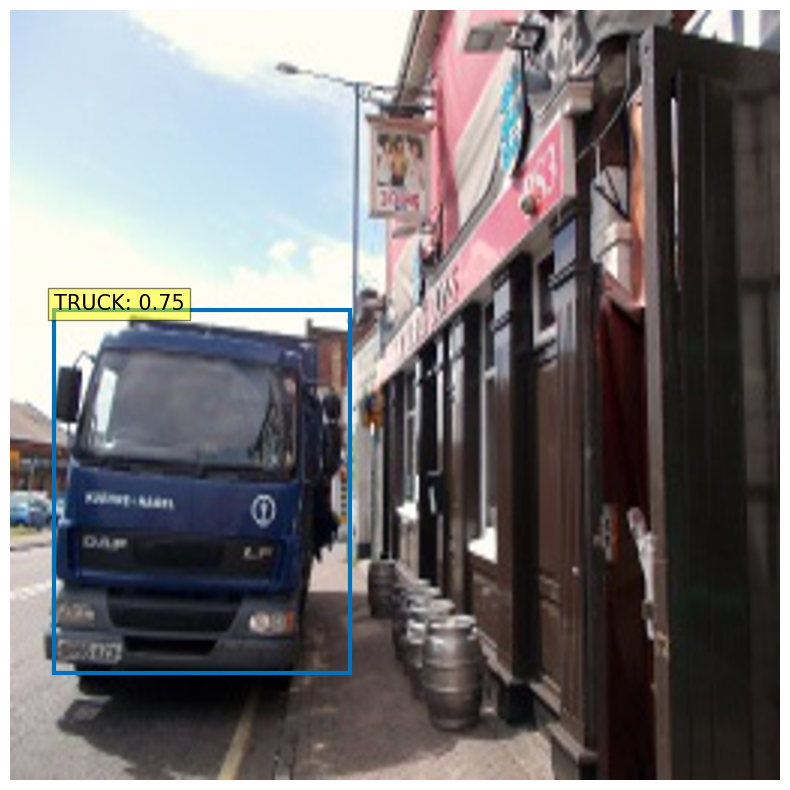

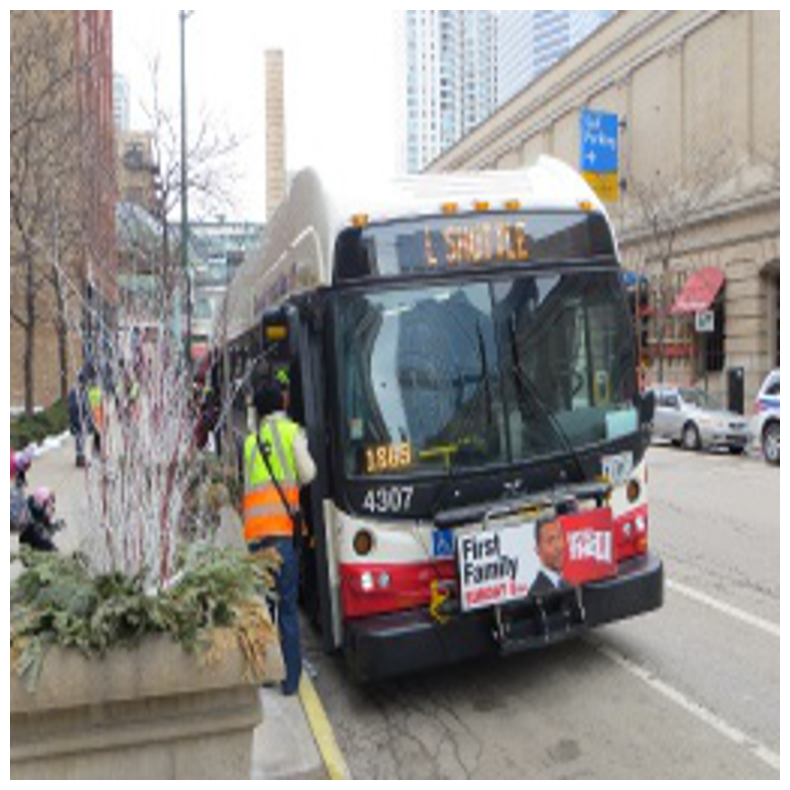

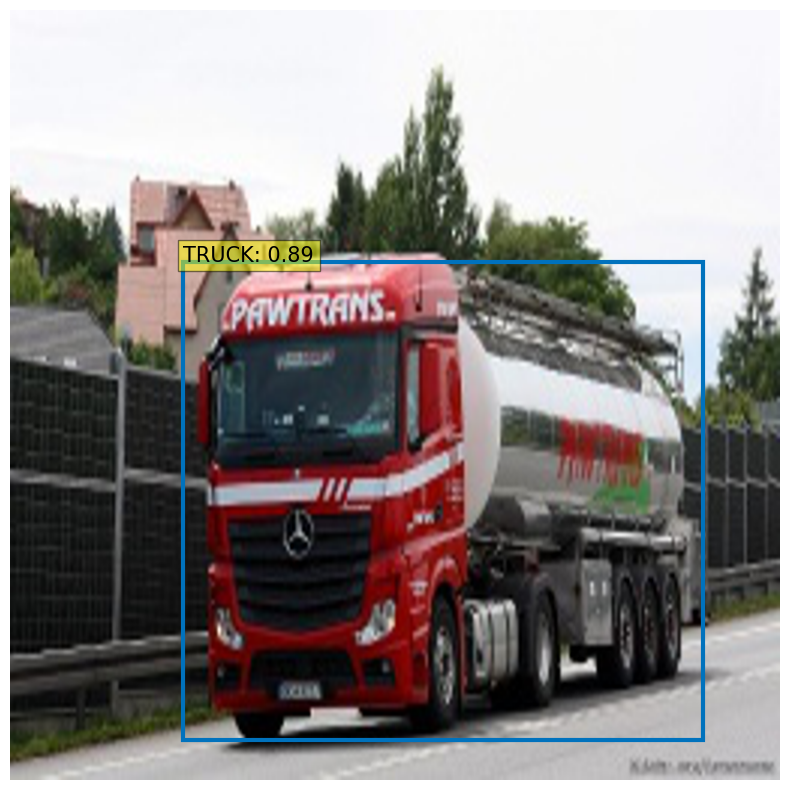

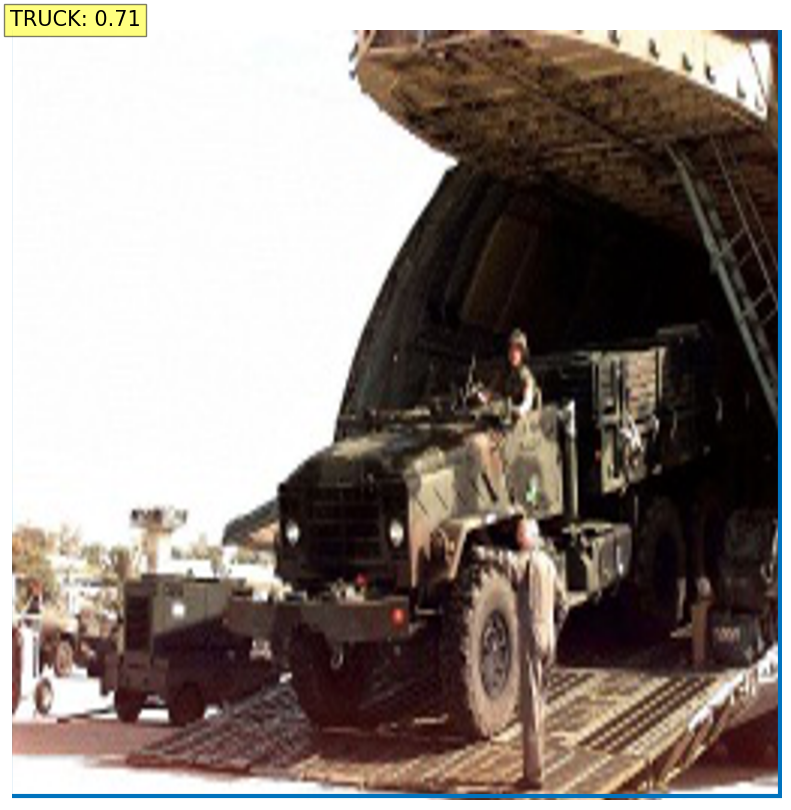

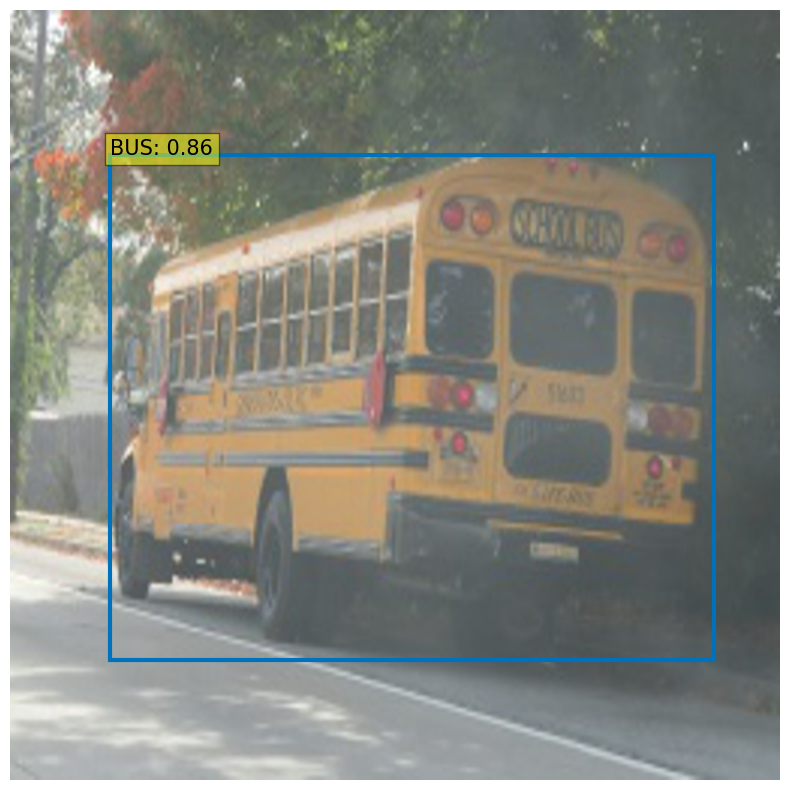

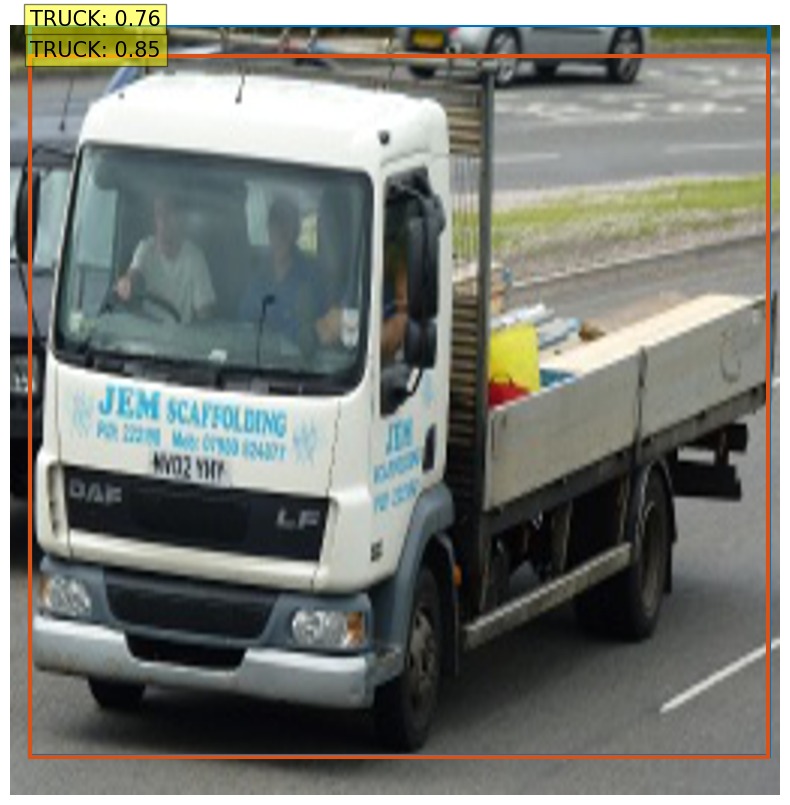

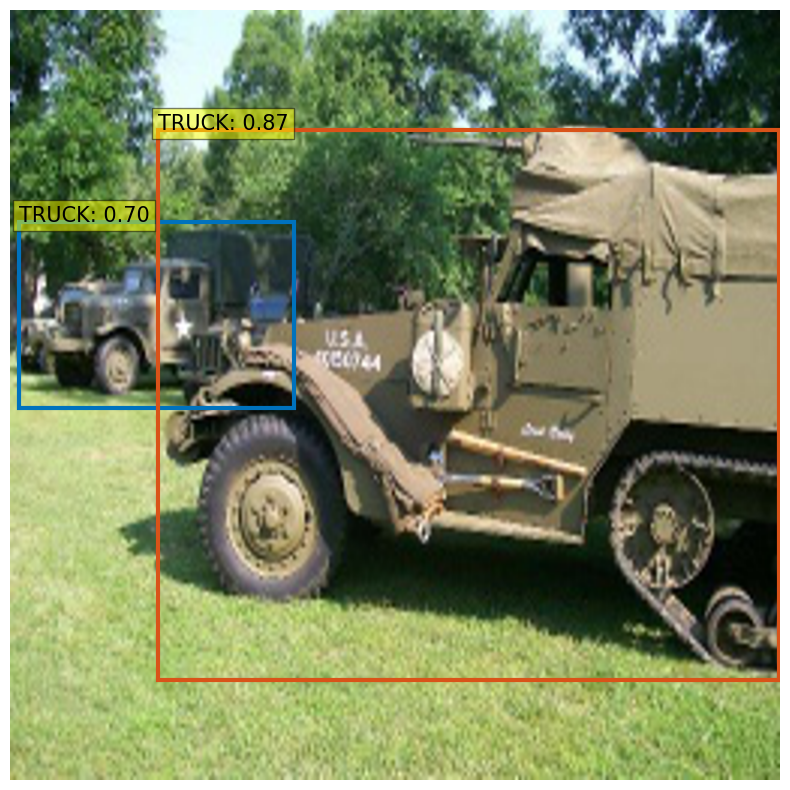

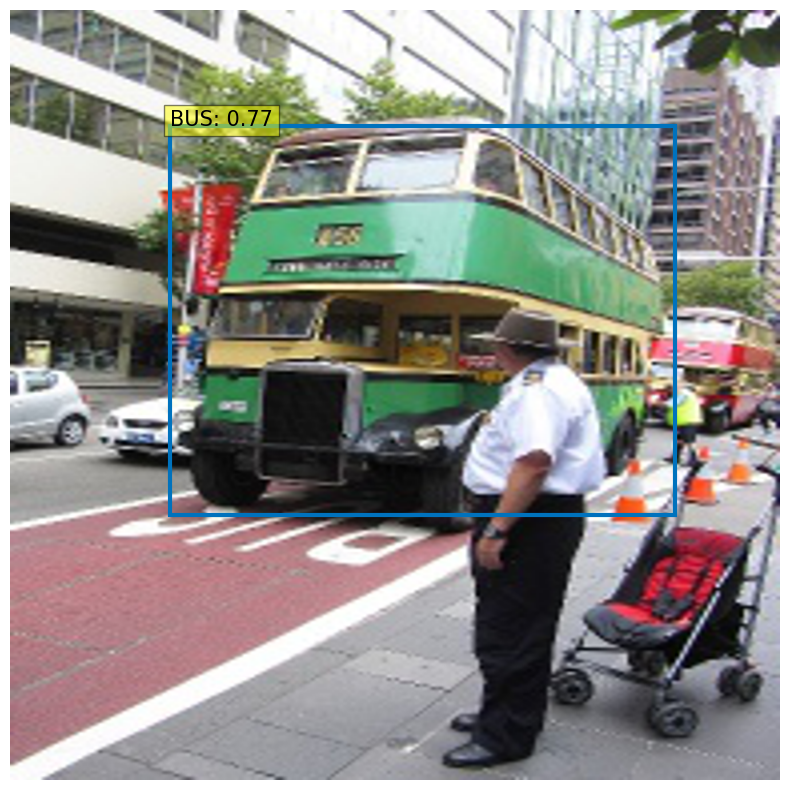

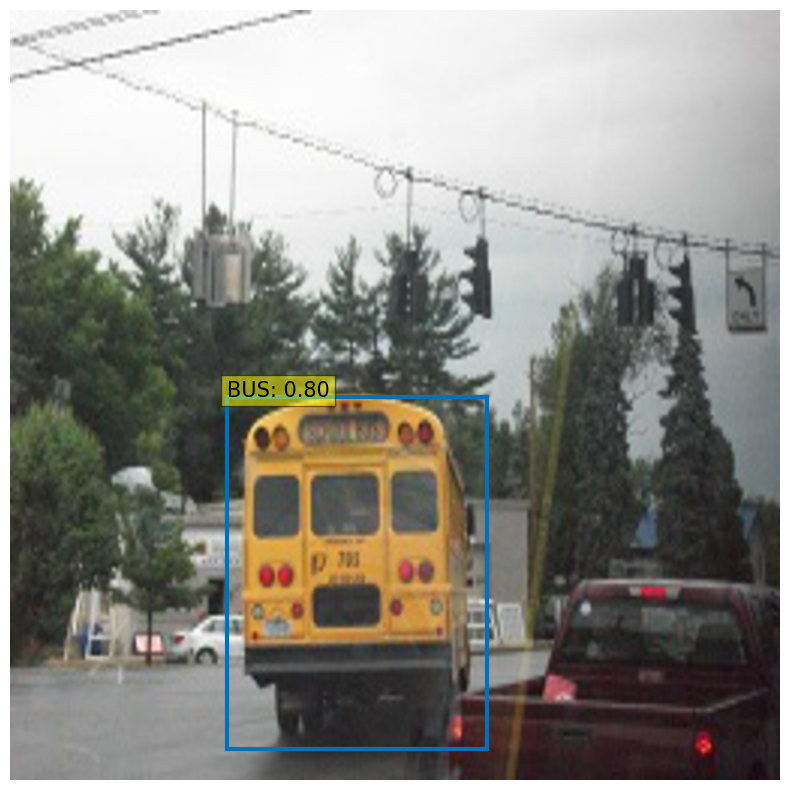

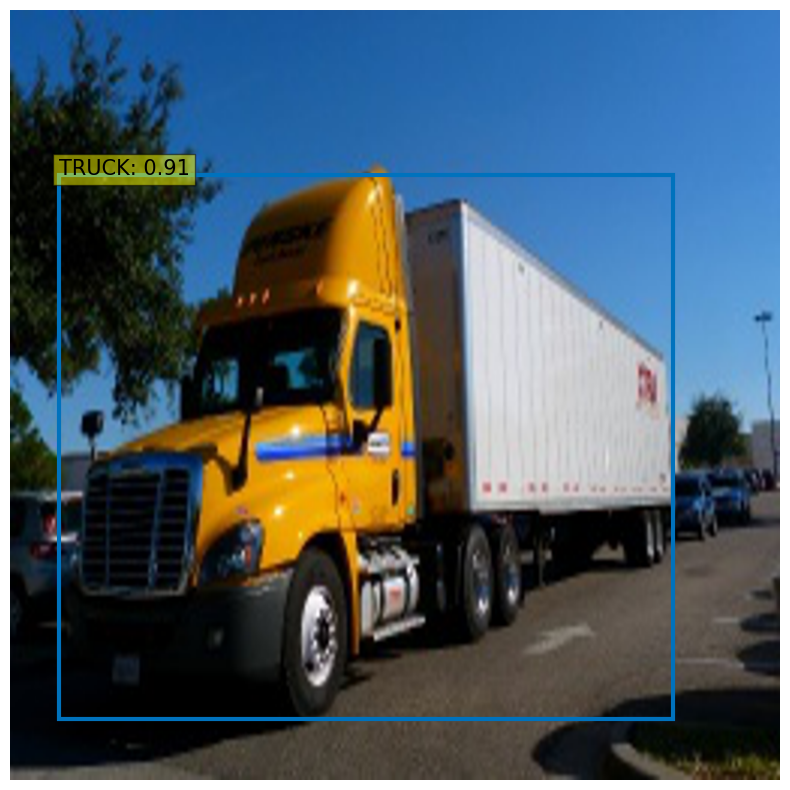

In [70]:
# Perform object detection on sample images
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for _ in range(10):
    # Choose a random image from the dataset
    image = Image.open(choose(Glob('../Data/open-images-bus-trucks/images/*'))).resize((800,800)).convert('RGB')
    # Detect objects in the image using the trained model
    scores, boxes = detect(image, model, transform)
     # Visualize the results
    plot_results(image, scores, boxes)

In [8]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --batch_size 2 --no_aux_loss --eval --output_dir DETR_output_fpgm --resume DETR_output_fpgm/best_checkpoint.pth --coco_path ../Data/open-images-bus-trucks





*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 0): env://
| distributed init (rank 2): env://
| distributed init (rank 1): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Test:  [ 0/29]  eta: 0:00:42  class_error: 100.00  loss: 1.5236 (1.5236)  loss_bbox: 0.4266 (0.4266)  loss_ce: 0.4317 (0.4317)  loss_giou: 0.6652 (0.6652)  cardinality_error_unscaled: 1.1667 (1.1667)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.0853 (0.0853)  loss_ce_unscaled: 0.4317 (0.4317)  loss_giou_unscaled: 0.3326 (0.3326)  time: 1.4622  data: 0.3088  max mem: 102

In [198]:
"""
Plotting utilities to visualize training logs.
"""
import torch
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from pathlib import Path, PurePath


def plot_logs(logs, fields=('class_error', 'loss_bbox_unscaled', 'mAP'), ewm_col=0, log_name='log.txt', output_dir=None):
    '''
    Function to plot specific fields from training log(s). Plots both training and test results.

    :: Inputs - logs = list containing Path objects, each pointing to individual dir with a log file
              - fields = which results to plot from each log file - plots both training and test for each field.
              - ewm_col = optional, which column to use as the exponential weighted smoothing of the plots
              - log_name = optional, name of log file if different than default 'log.txt'.

    :: Outputs - matplotlib plots of results in fields, color coded for each log file.
               - solid lines are training results, dashed lines are test results.

    '''
    func_name = "plot_utils.py::plot_logs"

    # Verify logs is a list of Paths (list[Paths]) or single Pathlib object Path,
    # convert single Path to list to avoid 'not iterable' error

    if not isinstance(logs, list):
        if isinstance(logs, PurePath):
            logs = [logs]
            print(f"{func_name} info: logs param expects a list argument, converted to list[Path].")
        else:
            raise ValueError(f"{func_name} - invalid argument for logs parameter.\n \
            Expect list[Path] or single Path obj, received {type(logs)}")

    # Quality checks - verify valid dir(s), that every item in list is Path object, and that log_name exists in each dir
    for i, dir in enumerate(logs):
        if not isinstance(dir, PurePath):
            raise ValueError(f"{func_name} - non-Path object in logs argument of {type(dir)}: \n{dir}")
        if not dir.exists():
            raise ValueError(f"{func_name} - invalid directory in logs argument:\n{dir}")
        # Verify log_name exists
        fn = Path(dir / log_name)
        if not fn.exists():
            print(f"-> missing {log_name}.  Have you gotten to Epoch 1 in training?")
            print(f"--> full path of missing log file: {fn}")
            return

    # Load log file(s) and plot
    dfs = [pd.read_json(Path(p) / log_name, lines=True) for p in logs]

    fig, axs = plt.subplots(ncols=len(fields), figsize=(16, 5))

    for df, color, dir in zip(dfs, sns.color_palette(n_colors=len(logs)), logs):
        for j, field in enumerate(fields):
            if field == 'mAP':
                coco_eval = pd.DataFrame(
                    np.stack(df.test_coco_eval_bbox.dropna().values)[:, 0]
                ).ewm(com=ewm_col).mean()
                axs[j].plot(coco_eval, c=color, label=f'{Path(dir).name} test_{field}', linestyle='--')
            else:
                # Ensure columns are numeric
                train_field = f'train_{field}'
                test_field = f'test_{field}'
                
                df[train_field] = pd.to_numeric(df[train_field], errors='coerce')
                df[test_field] = pd.to_numeric(df[test_field], errors='coerce')

                # Drop non-numeric columns
                df_numeric = df[[train_field, test_field]].dropna()

                df_numeric.interpolate().ewm(com=ewm_col).mean().plot(
                    y=[train_field, test_field],
                    ax=axs[j],
                    color=[color] * 2,
                    style=['-', '--'],  # Solid line for training, dashed line for test
                    label=[f'{Path(dir).name} {train_field}', f'{Path(dir).name} {test_field}']
                )
    for ax, field in zip(axs, fields):
        ax.legend()
        ax.set_title(field)

    if output_dir:
        fig.savefig(Path(output_dir) / "training_plots.png")


def plot_precision_recall(files, naming_scheme='iter'):
    if naming_scheme == 'exp_id':
        # name becomes exp_id
        names = [f.parts[-3] for f in files]
    elif naming_scheme == 'iter':
        names = [f.stem for f in files]
    else:
        raise ValueError(f'not supported {naming_scheme}')
    fig, axs = plt.subplots(ncols=2, figsize=(16, 5))
    for f, color, name in zip(files, sns.color_palette("Blues", n_colors=len(files)), names):
        data = torch.load(f)
        # precision is n_iou, n_points, n_cat, n_area, max_det
        precision = data['precision']
        recall = data['params'].recThrs
        scores = data['scores']
        # take precision for all classes, all areas and 100 detections
        precision = precision[0, :, :, 0, -1].mean(1)
        scores = scores[0, :, :, 0, -1].mean(1)
        prec = precision.mean()
        rec = data['recall'][0, :, 0, -1].mean()
        print(f'{naming_scheme} {name}: mAP@50={prec * 100: 05.1f}, ' +
              f'score={scores.mean():0.3f}, ' +
              f'f1={2 * prec * rec / (prec + rec + 1e-8):0.3f}'
              )
        axs[0].plot(recall, precision, c=color, label=name)
        axs[1].plot(recall, scores, c=color, label=name)

    axs[0].set_title('Precision / Recall')
    axs[0].legend()
    axs[1].set_title('Scores / Recall')
    axs[1].legend()
    return fig, axs


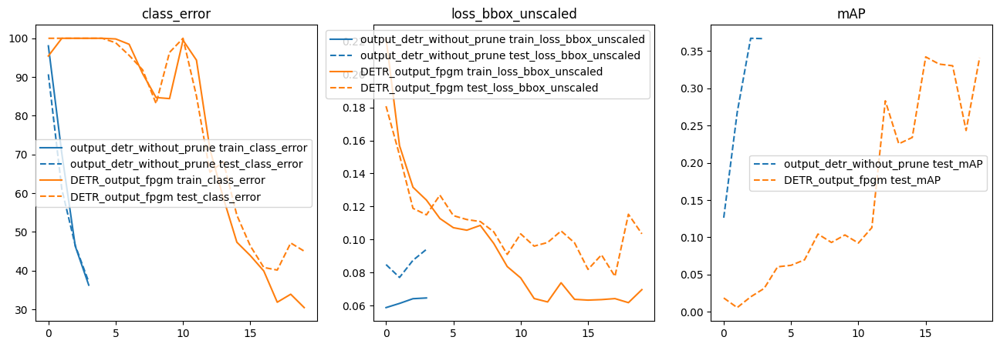

In [214]:
from pathlib import Path

# List of directories containing log files
log_dirs = [Path('output_detr_without_prune'), Path('DETR_output_fpgm'),]

# Plot logs
plot_logs(log_dirs)


In [197]:
fields_of_interest = (
    'loss',
    'mAP',
    'class_error',
    )

plot_logs(log_directory,
          fields_of_interest)

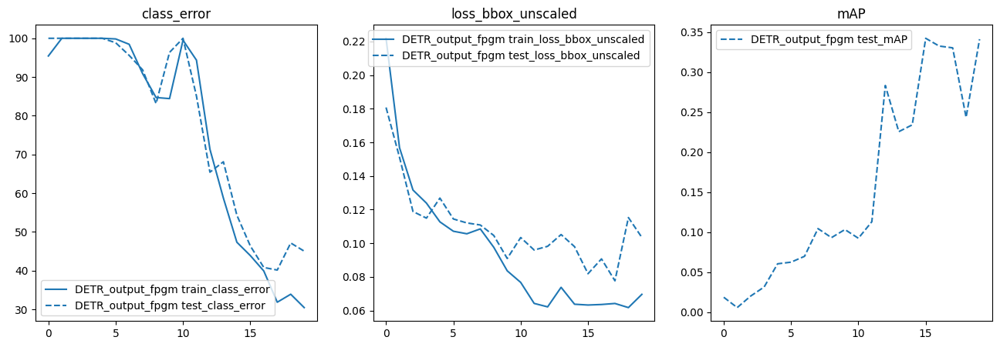

In [209]:
plot_logs(log_directory, output_dir="DETR_output_fpgm")


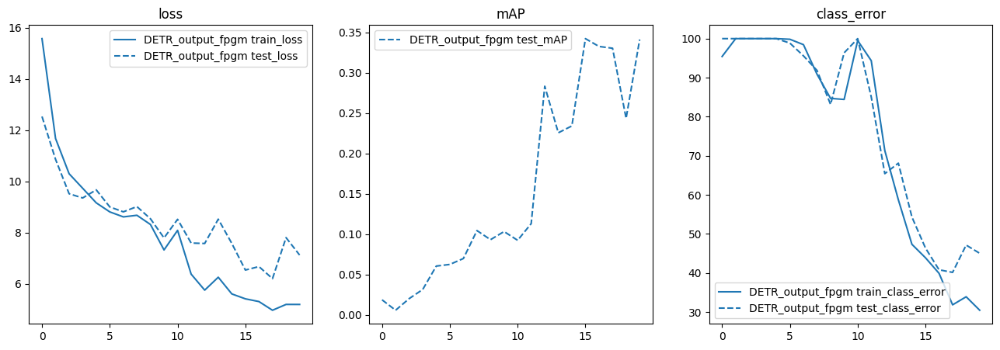

In [201]:
fields_of_interest = (
    'loss',
    'mAP',
    'class_error',
    )

plot_logs(log_directory,
          fields_of_interest)